## Визуализация данных с Matplotlib и Seaborn
### Подключение библиотек и скриптов

In [1]:
import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt # Модуль пайплот!!!
import seaborn as sns

In [3]:
df = pd.read_csv('bank.csv', sep=',')
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,oct,79,1,-1,0,unknown,0
1,33,services,married,secondary,no,4789,yes,yes,cellular,11,may,220,1,339,4,failure,0
2,35,management,single,tertiary,no,1350,yes,no,cellular,16,apr,185,1,330,1,failure,0
3,30,management,married,tertiary,no,1476,yes,yes,unknown,3,jun,199,4,-1,0,unknown,0
4,59,blue-collar,married,secondary,no,0,yes,no,unknown,5,may,226,1,-1,0,unknown,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4516,33,services,married,secondary,no,-333,yes,no,cellular,30,jul,329,5,-1,0,unknown,0
4517,57,self-employed,married,tertiary,yes,-3313,yes,yes,unknown,9,may,153,1,-1,0,unknown,0
4518,57,technician,married,secondary,no,295,no,no,cellular,19,aug,151,11,-1,0,unknown,0
4519,28,blue-collar,married,secondary,no,1137,no,no,cellular,6,feb,129,4,211,3,other,0


In [4]:
df['month'].value_counts()

may    1398
jul     706
aug     633
jun     531
nov     389
apr     293
feb     222
jan     148
oct      80
sep      52
mar      49
dec      20
Name: month, dtype: int64

In [5]:
df['month_new'] = 0

In [6]:
df['convert'] = df['y']

In [7]:
lst_month = []
for i in df['month']:
    if i == 'may':
        lst_month.append(5)
    elif i == 'jul':
        lst_month.append(7)
    elif i == 'aug':
        lst_month.append(8)    
    elif i == 'jun':
        lst_month.append(6) 
    elif i == 'nov':
        lst_month.append(11) 
    elif i == 'apr':
        lst_month.append(4)     
    elif i == 'feb':
        lst_month.append(2)  
    elif i == 'jan':
        lst_month.append(1) 
    elif i == 'oct':
        lst_month.append(10) 
    elif i == 'sep':
        lst_month.append(9) 
    elif i == 'mar':
        lst_month.append(3)         
    elif i == 'dec':
        lst_month.append(12)         

In [8]:
df['month_new'] = lst_month
df['month_new'].value_counts()

5     1398
7      706
8      633
6      531
11     389
4      293
2      222
1      148
10      80
9       52
3       49
12      20
Name: month_new, dtype: int64

In [9]:
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,month_new,convert
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,oct,79,1,-1,0,unknown,0,10,0
1,33,services,married,secondary,no,4789,yes,yes,cellular,11,may,220,1,339,4,failure,0,5,0
2,35,management,single,tertiary,no,1350,yes,no,cellular,16,apr,185,1,330,1,failure,0,4,0
3,30,management,married,tertiary,no,1476,yes,yes,unknown,3,jun,199,4,-1,0,unknown,0,6,0
4,59,blue-collar,married,secondary,no,0,yes,no,unknown,5,may,226,1,-1,0,unknown,0,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4516,33,services,married,secondary,no,-333,yes,no,cellular,30,jul,329,5,-1,0,unknown,0,7,0
4517,57,self-employed,married,tertiary,yes,-3313,yes,yes,unknown,9,may,153,1,-1,0,unknown,0,5,0
4518,57,technician,married,secondary,no,295,no,no,cellular,19,aug,151,11,-1,0,unknown,0,8,0
4519,28,blue-collar,married,secondary,no,1137,no,no,cellular,6,feb,129,4,211,3,other,0,2,0


Стандартный синтаксис создания графика
##### Ниже пример!!!

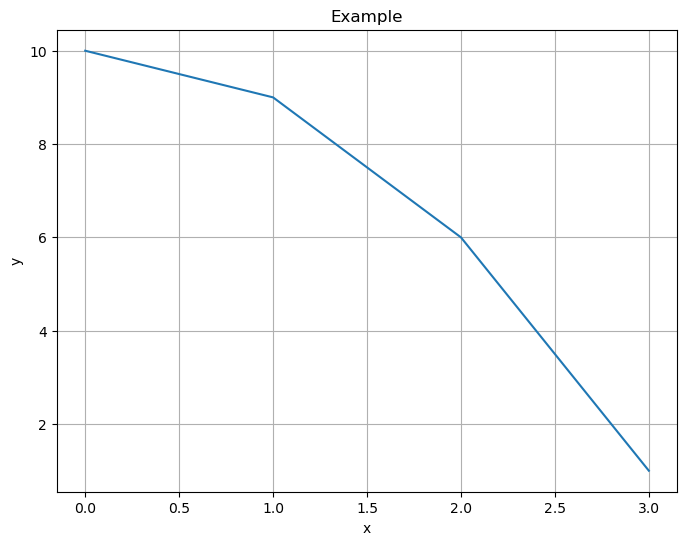

In [10]:
plt.figure(figsize=(8, 6))
plt.plot([0, 1, 2, 3], [10, 9, 6, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid();

## Виды графиков
### Линейный график

In [11]:
df['month'].value_counts()

may    1398
jul     706
aug     633
jun     531
nov     389
apr     293
feb     222
jan     148
oct      80
sep      52
mar      49
dec      20
Name: month, dtype: int64

In [12]:
# Готовим данные для графика в виде сводной таблицы

data = df.groupby('month_new')['job'].agg(count='count').reset_index().sort_values(by='month_new')
data.head(12)

,month_new,count
0,1,148
1,2,222
2,3,49
3,4,293
4,5,1398
5,6,531
6,7,706
7,8,633
8,9,52
9,10,80


### Matplotlib

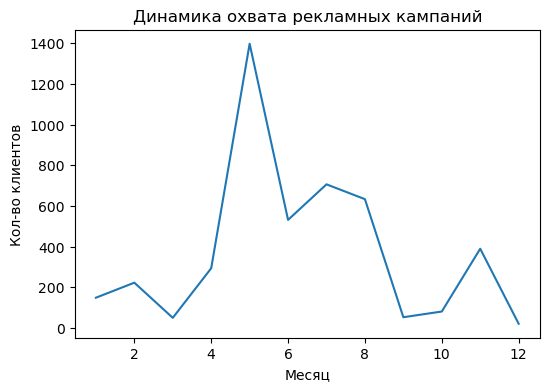

In [13]:
plt.figure(figsize=(6, 4))

plt.plot(data['month_new'], data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

### Seaborn

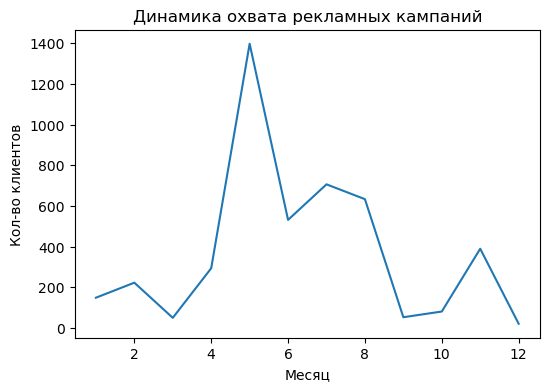

In [14]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data['month_new'], y=data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

### Гистограмма
##### Matplotlib

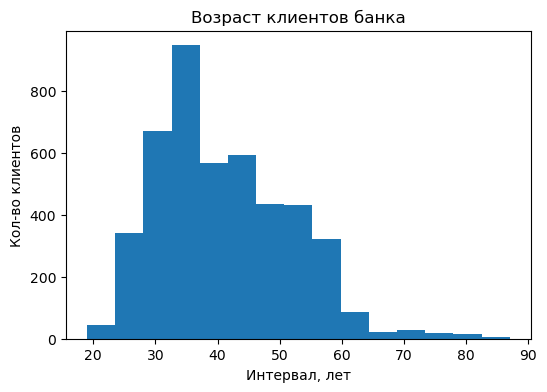

In [15]:
plt.figure(figsize=(6, 4))

plt.hist(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

#### Seaborn

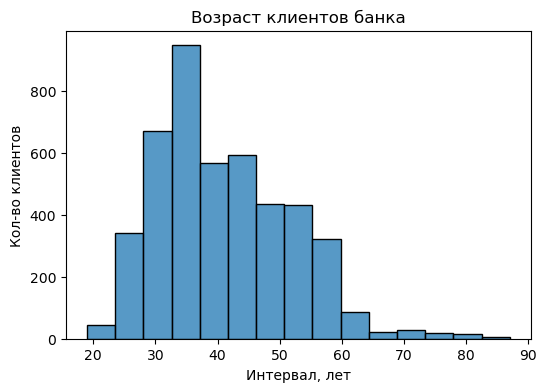

In [16]:
plt.figure(figsize=(6, 4))

sns.histplot(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

### Диаграмма рассеяния

In [17]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('age')['convert'].sum().reset_index()
data.head()

,age,convert
0,19,2
1,20,1
2,21,1
3,22,3
4,23,2


### Matplotlib

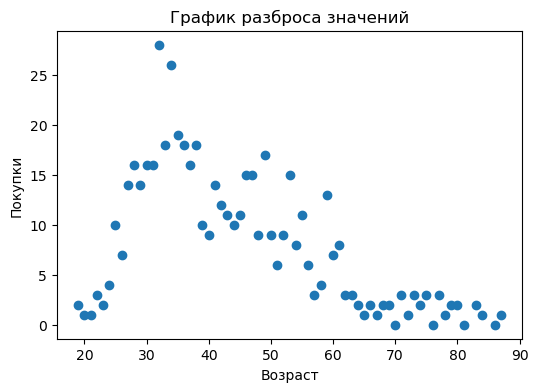

In [18]:
plt.figure(figsize=(6, 4))

plt.scatter(data['age'], data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

### Seaborn

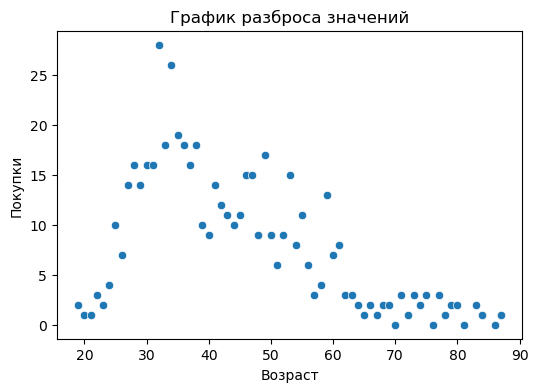

In [19]:
plt.figure(figsize=(6, 4))

sns.scatterplot(x=data['age'], y=data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

### Столбчатые диаграммы

In [20]:
# Готовим данные для графика
data = df['job'].value_counts().reset_index()
data.head()

,index,job
0,management,969
1,blue-collar,946
2,technician,768
3,admin.,478
4,services,417


### Matplotlib

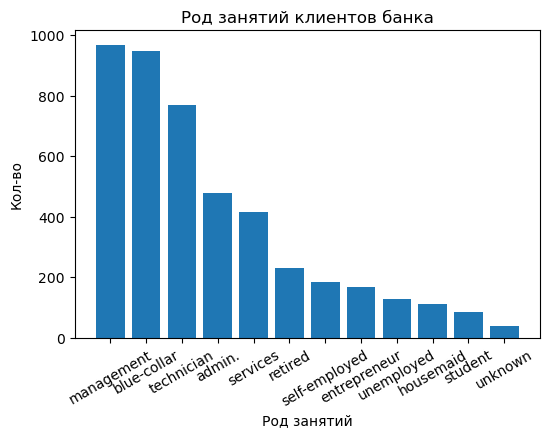

In [21]:
plt.figure(figsize=(6, 4))

plt.bar(data['index'], data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

### Seaborn

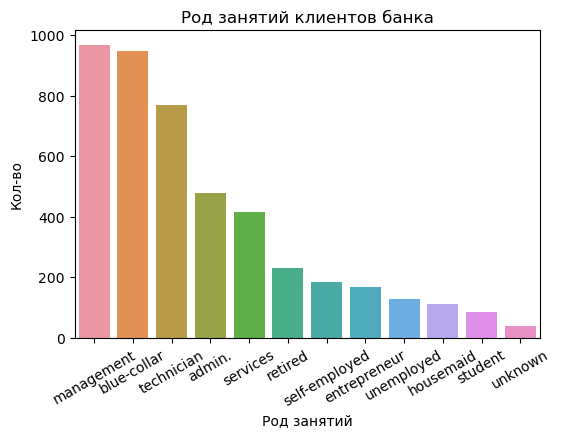

In [22]:
plt.figure(figsize=(6, 4))

sns.barplot(x=data['index'], y=data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

### Многорядовые столбчатые диаграммы

In [23]:
df.head(1)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,month_new,convert
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,oct,79,1,-1,0,unknown,0,10,0


In [24]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,877,69
4,management,838,131
9,technician,685,83
0,admin.,420,58
7,services,379,38


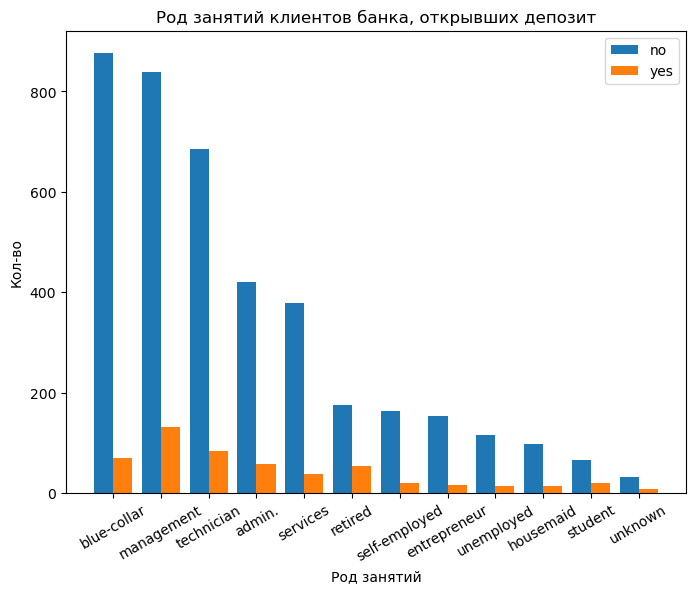

In [25]:
# Строим столбчатую многорядную диаграмму

plt.figure(figsize=(8, 6))

# определяем кол-во делений
n_ticks = np.arange(len(data['no']))

# определяем сдвиг
offset = 0.2

# определяем ширину столбцов
w = 0.4

# добавляем сдвиг к кол-ву делений
plt.bar(n_ticks - offset, data['no'], width=w)
plt.bar(n_ticks + offset, data['yes'], width=w)

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation = 30);  # добавляем метки делений

### Сложенная столбчатая диаграмма

In [26]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,0.927061,0.072939
2,entrepreneur,0.910714,0.089286
7,services,0.908873,0.091127
10,unemployed,0.898438,0.101562
9,technician,0.891927,0.108073


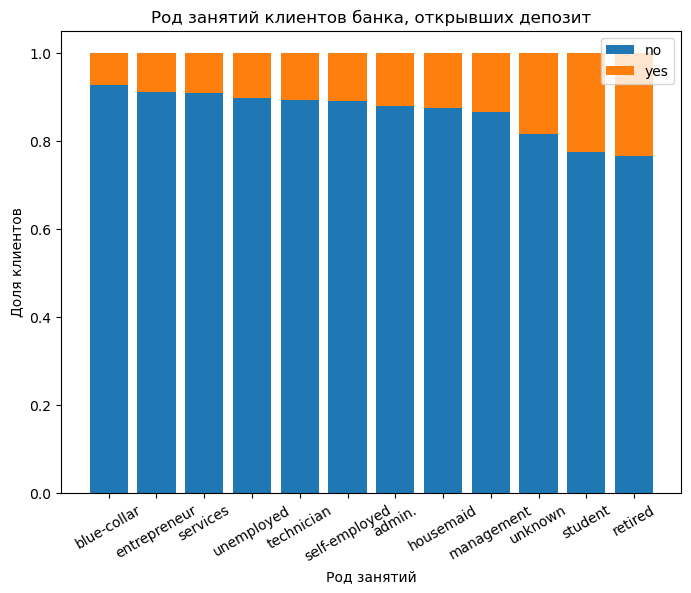

In [27]:
# Строим столбчатую многорядную сложенную диаграмму

plt.figure(figsize=(8, 6))

plt.bar(data['job'], data['no'])
plt.bar(data['job'], data['yes'], bottom=data['no'])

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes'])
plt.xticks(rotation = 30);

### Ящики с усами

In [28]:
# Готовим данные для графика
data1 = df['duration'][df['convert'] == 1]
data2 = df['duration'][df['convert'] == 0]
data1.head()

13    261
30    897
33    958
34    354
36     97
Name: duration, dtype: int64

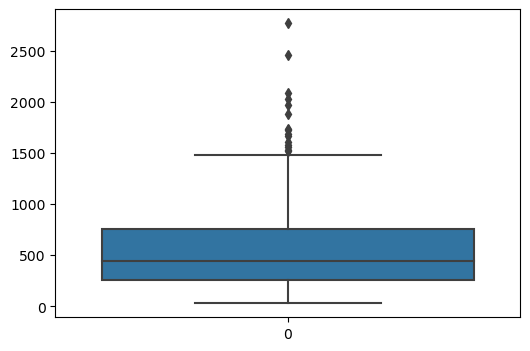

In [29]:
plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1]);

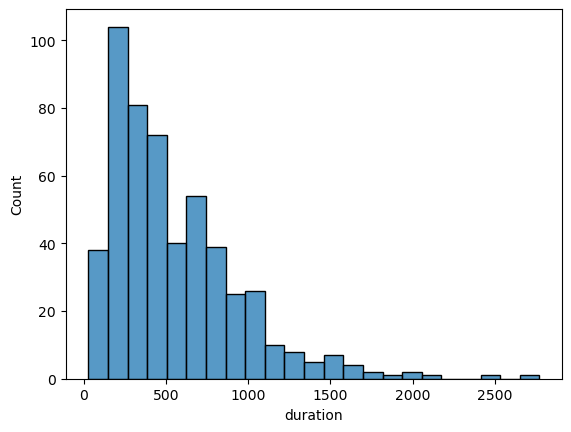

In [30]:
sns.histplot(x=data1);

### Matplotlib

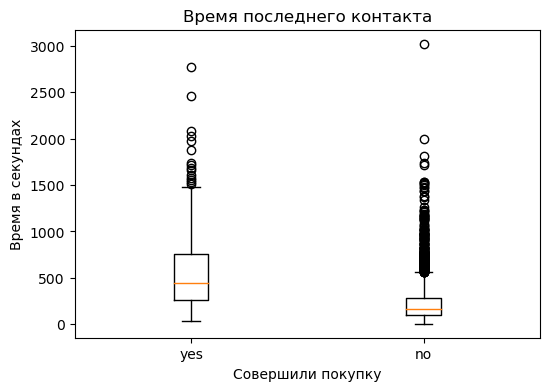

In [31]:
# Строим боксплот

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2])

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

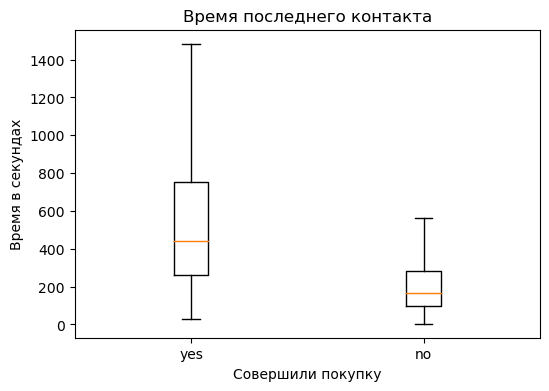

In [32]:
# Строим боксплот без выбросов 

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

### Seaborn

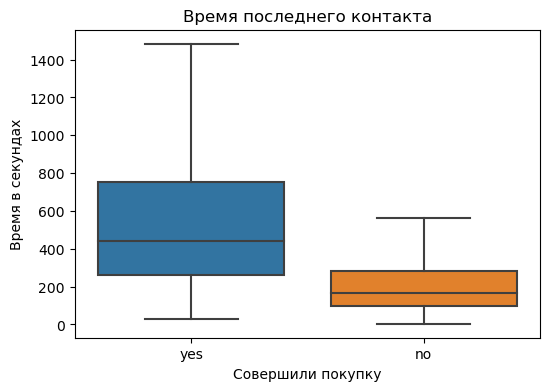

In [33]:
# Строим боксплот без выбросов 

plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([0, 1], ['yes', 'no']);

### Круговая диаграмма

In [34]:
# Готовим данные для графика
data = df['convert'].value_counts()
data.index = ['no', 'yes']
data.head()

no     4000
yes     521
Name: convert, dtype: int64

#### Matplotlib

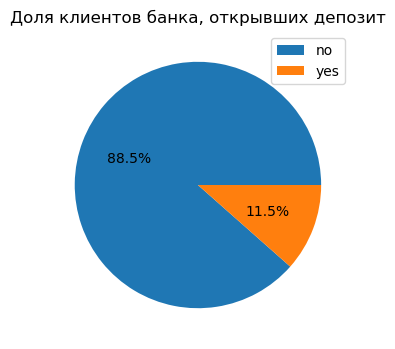

In [35]:
# Строим круговую диаграмму

plt.figure(figsize=(6, 4))

plt.pie(data, autopct='%1.1f%%')

plt.title('Доля клиентов банка, открывших депозит')
plt.legend(data.index);

## Визуальный анализ данных
##### Описание датасета

##### Статистические данные о ряде домов в Калифорнии, основанные на переписи 1990 года.

- longitude - долгота
- latitude - широта
- housing_median_age - средний возраст дома
- total_rooms - общее количество комнат
- total_bedrooms - общее количество спален
- population - количество проживающих
- households - домохозяйства
- ocean_proximity - близость океана
- median_income - средний доход
- median_house_value - средняя стоимость дома

In [36]:
df = pd.read_csv('housing.csv')
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


In [37]:
df['ocean_proximity'].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

In [38]:
df['INLAND'] = 0

In [39]:
lst_inland = []
for i in df['ocean_proximity']:
    if i == 'INLAND':
        lst_inland.append(1)
    else:
        lst_inland.append(0)

In [40]:
df['INLAND'] = lst_inland

In [41]:
df['INLAND'].value_counts()

0    14089
1     6551
Name: INLAND, dtype: int64

### Распределение вещественных признаков

###### {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
###### [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

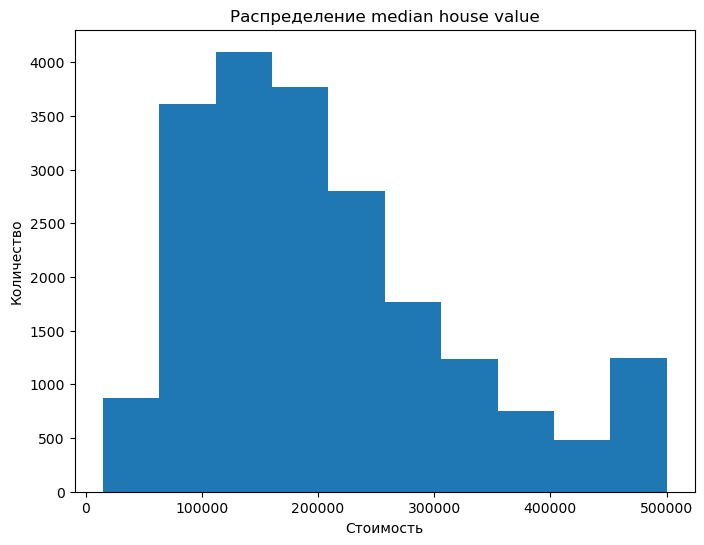

In [42]:
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

In [43]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)

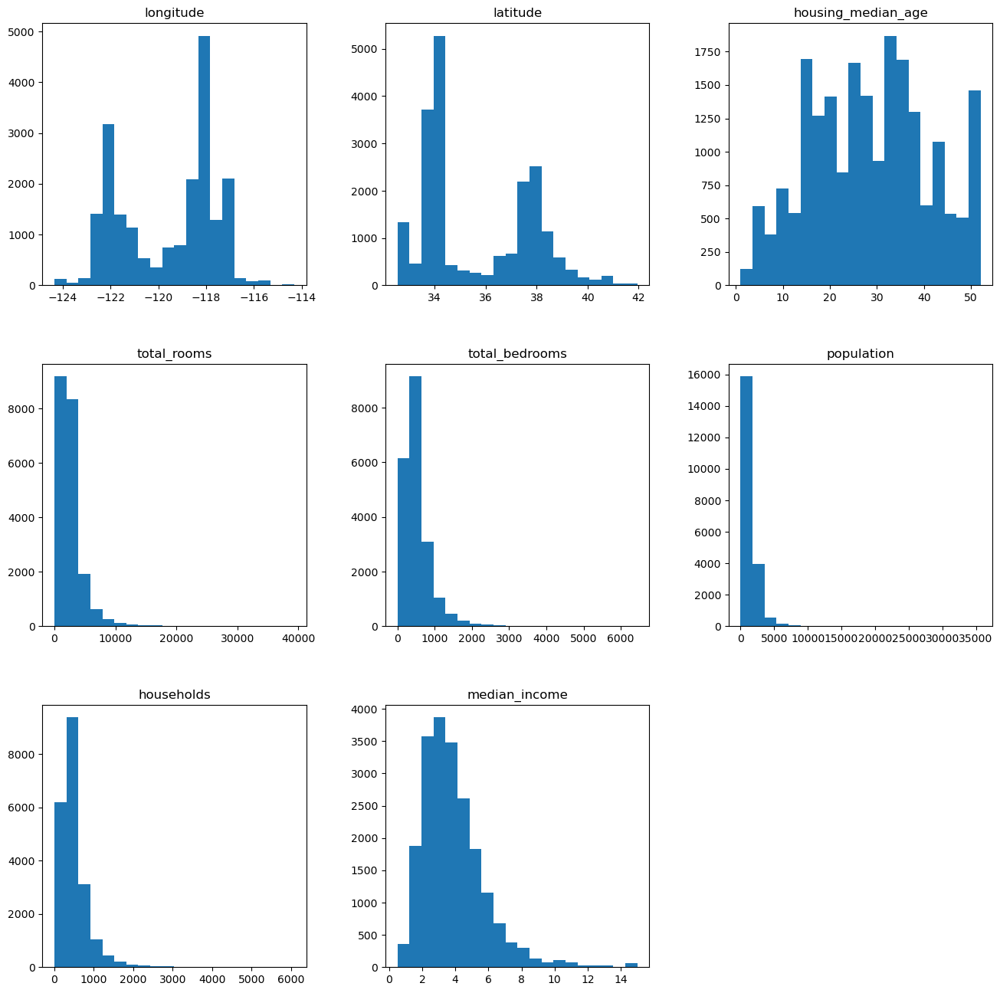

In [44]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

##### Поиск выбросов с помощью box plot

Как строится box plot<br>
Подробное объяснение<br>
box - от 25% до 75% квантиля линия в середине box - медиана "усы"<br>
Как строятся "усы" - вариантов масса<br>
среднее +/- 3 сигма (стандартное отклонение)<br>
min / max<br>
median +/- 1.5*(q75 - q25),<br>
...<br>
*Интерквартильный размах = q75 - q25<br>

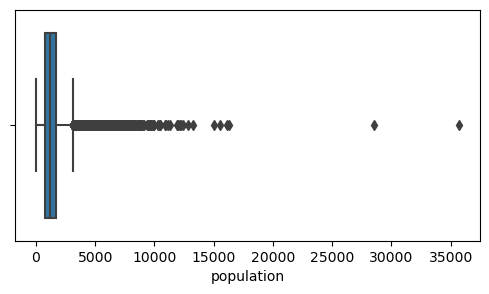

In [45]:
plt.figure(figsize=(6, 3))

sns.boxplot(x=df['population'], whis=1.5)

plt.xlabel('population')
plt.show()

#### Анализ категориальных признаков

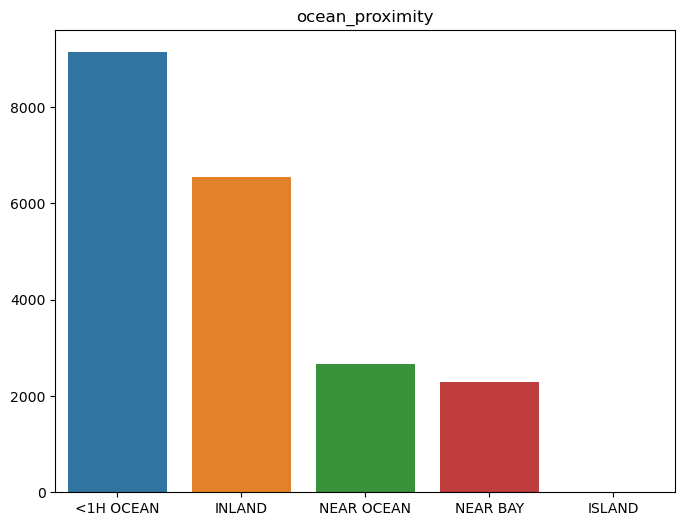

In [46]:
counts = df['ocean_proximity'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

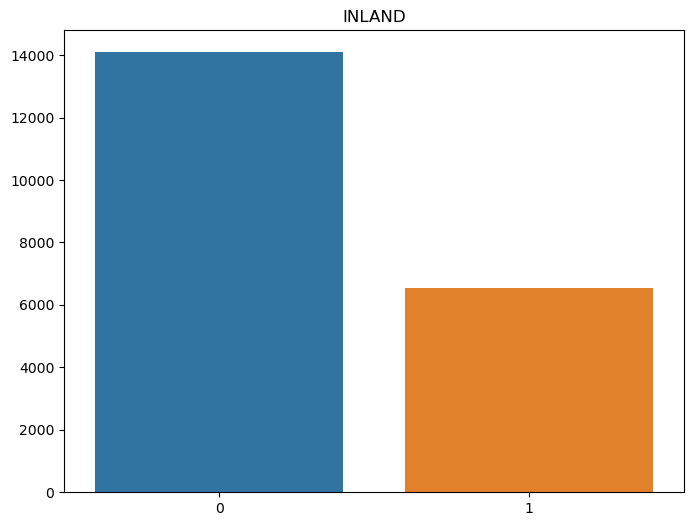

In [47]:
counts = df['INLAND'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('INLAND')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

### Анализ взаимных распределений

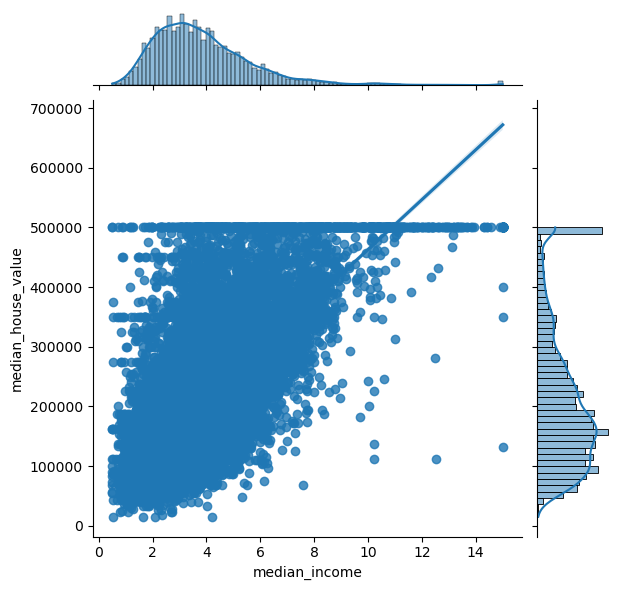

In [48]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

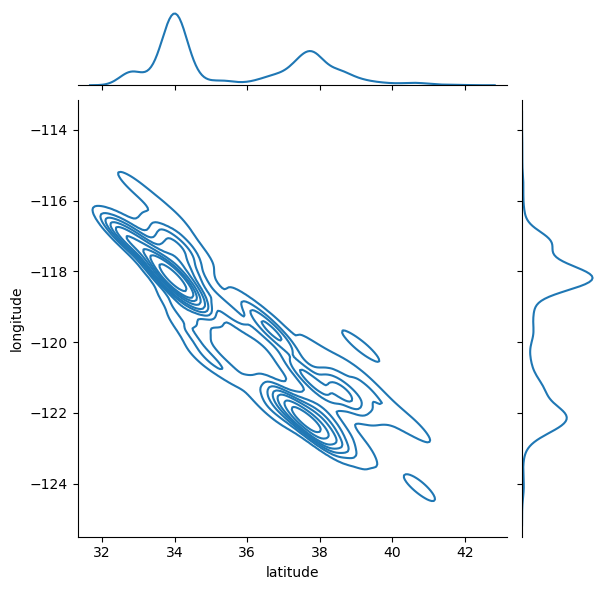

In [49]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

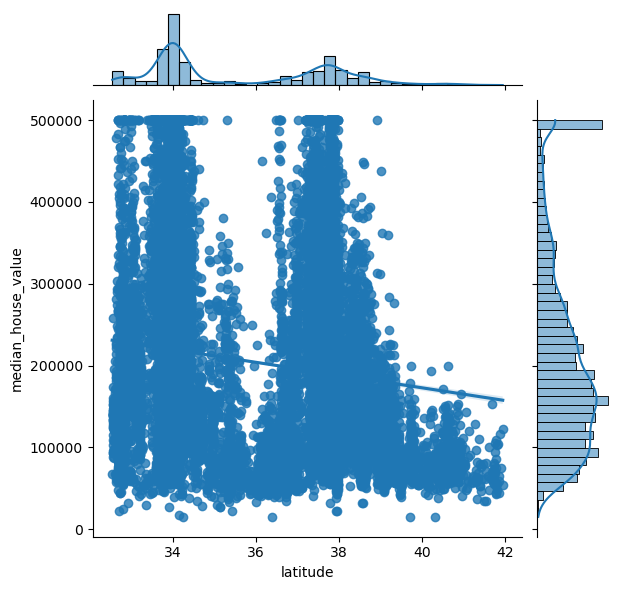

In [50]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

###### Видно два города, имеет смысл посмотреть на зависимость по отдельности

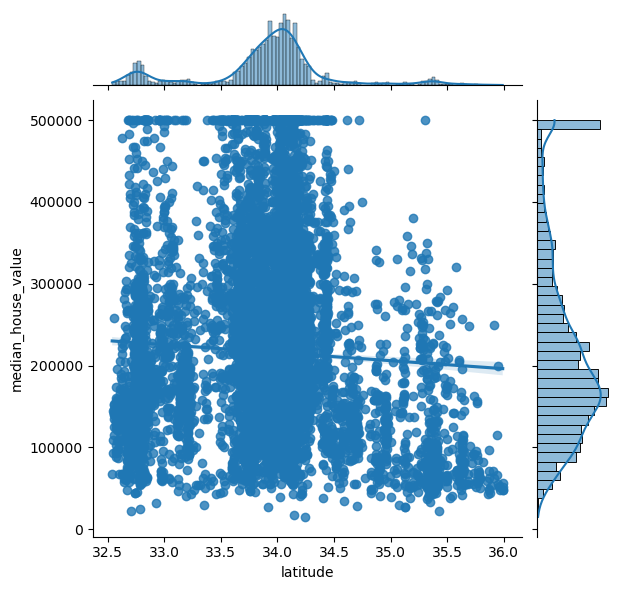

In [51]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

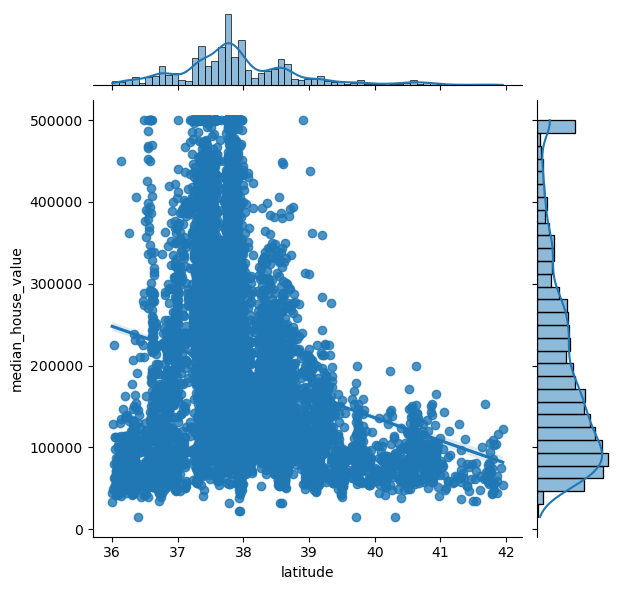

In [52]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

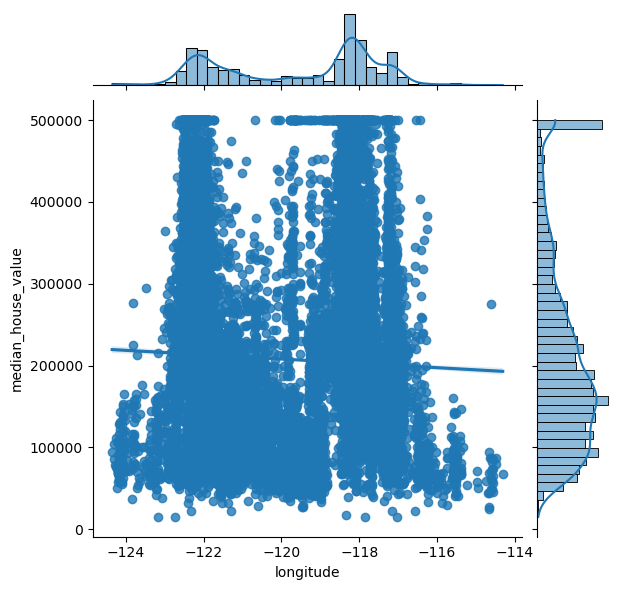

In [53]:
sns.jointplot(x=df['longitude'], y=df['median_house_value'], kind='reg');

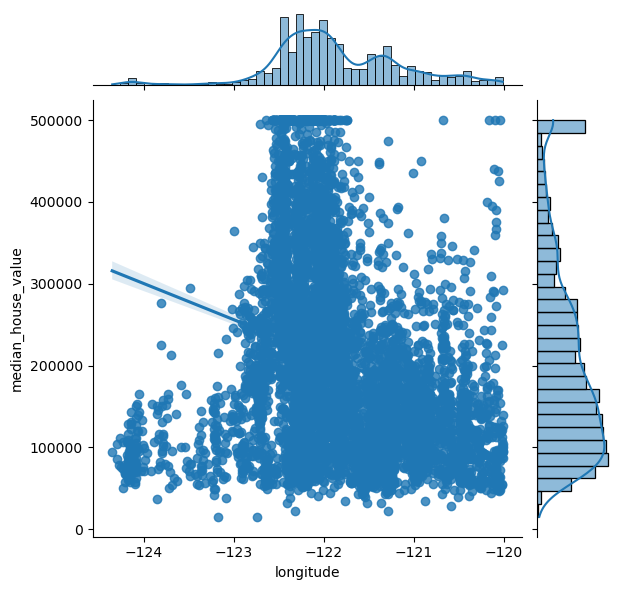

In [54]:
df_cut = df[df['longitude'] < -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

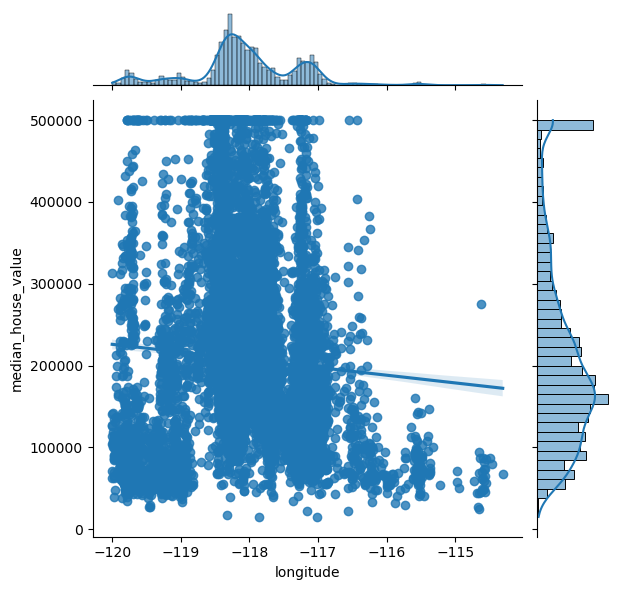

In [55]:
df_cut = df[df['longitude'] >= -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

#### Категориальные / бинарные признаки

#### box plot

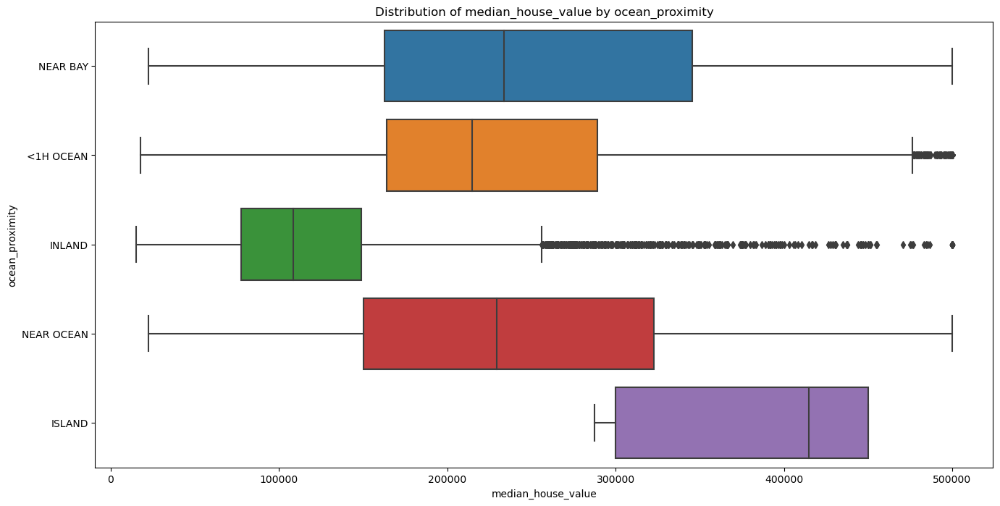

In [56]:
plt.figure(figsize=(16, 8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

### Как строится box plot

##### Подробное объяснение
- box - от 25% до 75% квантиля<br>
- линия в середине box - медиана<br>
- "усы"<br>
Как строятся "усы" - вариантов масса<br>
- среднее +/- 3 сигма (стандартное отклонение)<br>
- min / max<br>
- median +/- 1.5*(q75 - q25),<br>
...<br>
*Интерквартильный размах = q75 - q25<br>
## Матрица корреляций<br>
- Показывает линейную связь между переменными<br>
- Изменяется от -1 до 1<br>
- Корреляция - мера только линейной связи<br>

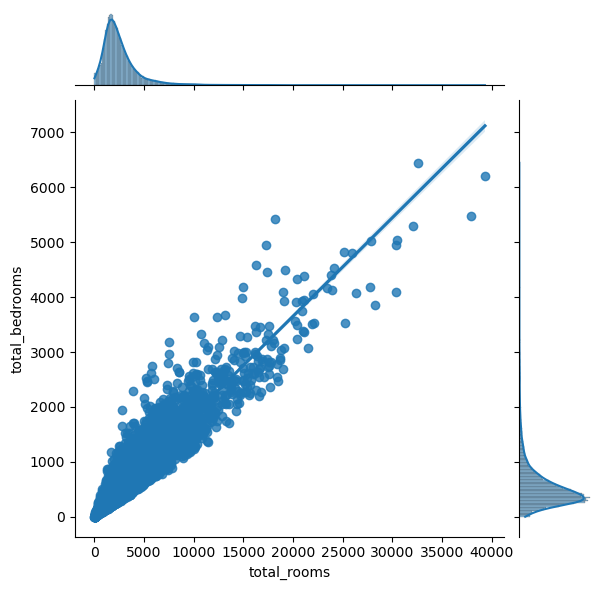

In [57]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

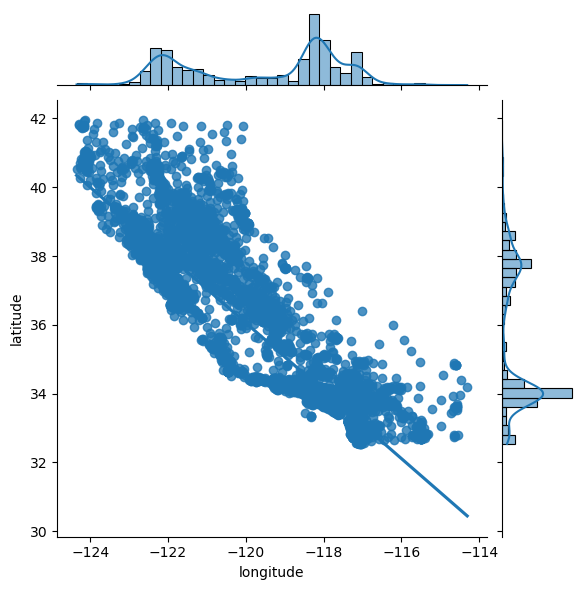

In [58]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');

In [59]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

C:\Users\ada89\AppData\Local\Temp\ipykernel_6436\4194942596.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,INLAND
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.4
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.9,0.9,0.0,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0,0.0
population,0.0,0.0,-0.3,0.9,0.9,1.0,0.9,0.0,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7,0.0
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0,-0.5
INLAND,0.0,0.4,0.0,0.0,0.0,0.0,0.0,0.0,-0.5,1.0


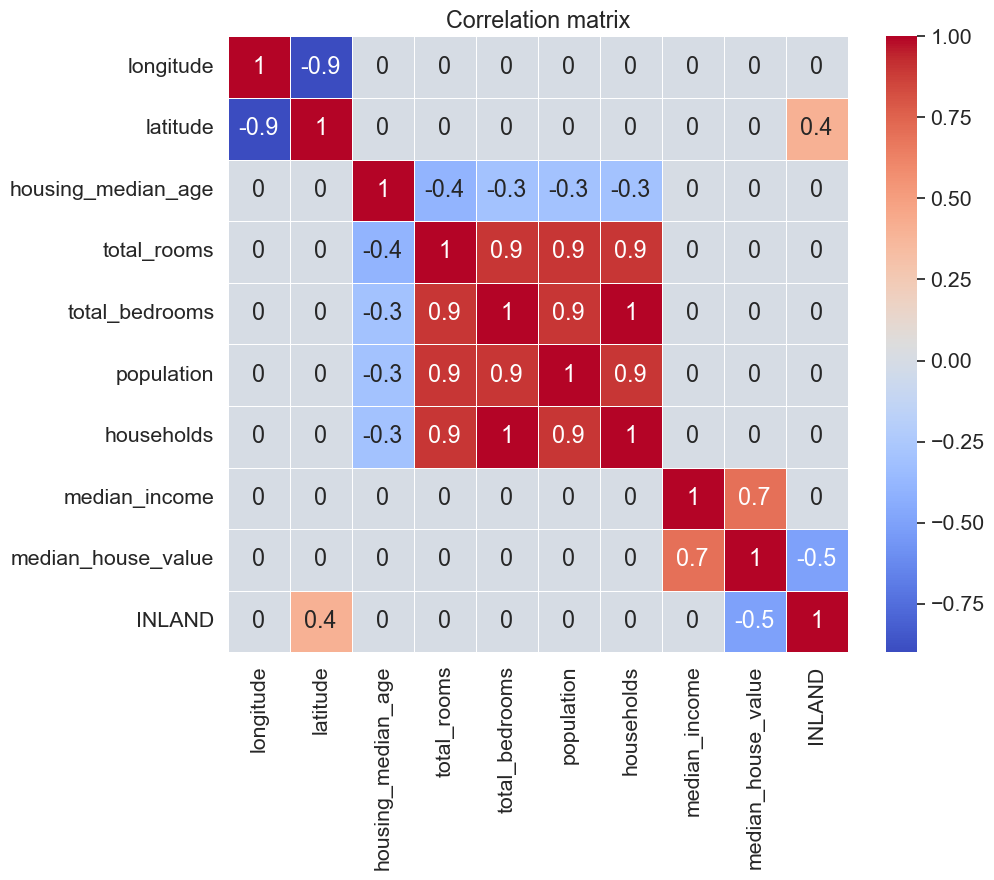

In [60]:
plt.figure(figsize=(10, 8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix');

# Гео данные

In [61]:
min_long = -124.55
max_long = -113.80

min_lat = 32.45
max_lat = 42.05

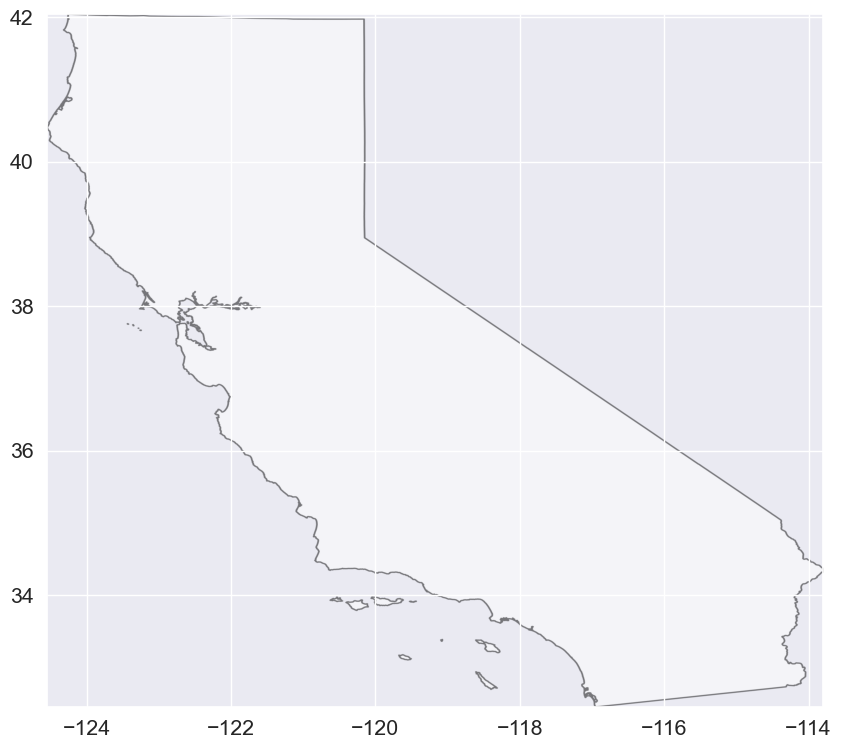

In [62]:
import matplotlib.image as img
california_map = img.imread('California_Map.png')

plt.figure(figsize=(12, 9))
plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5);

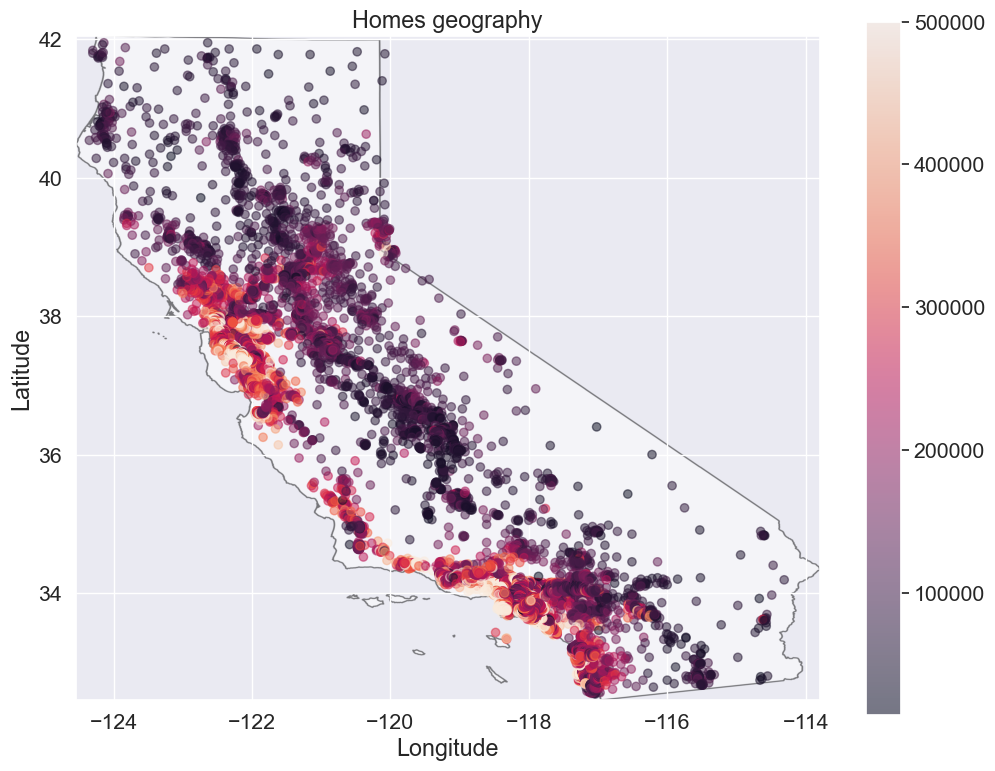

In [63]:
plt.figure(figsize=(12, 9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value'])

plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)

plt.colorbar(sc)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Homes geography");

### Folium

In [64]:
# !pip install folium

In [65]:
# !conda install -c conda-forge folium

In [66]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

### Kepler**

In [67]:
# !conda install -c conda-forge keplergl

In [68]:
# !pip install keplergl==0.1.1

In [69]:
from keplergl import KeplerGl 

map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
Map saved to ./california.html!


C:\Users\ada89\anaconda3\lib\site-packages\jupyter_client\session.py:718: UserWarning: Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant
  content = self.pack(content)


User Guide: https://docs.kepler.gl/docs/keplergl-jupyter<br>
Map saved to ./california.html!<br>
Summary<br>
Матрица корреляции<br>
Знакомство с признаками<br>
Плотность распределения (sns.distplot/sns.kdeplot/plt.hist - Узнать распределение признака)<br>
sns.violinplot - Узнать распределение признака<br>
Столбчатая диаграмма (sns.barplot/plt.bar - Узнать распределение категориального признака)<br>
Ящик с усами (sns.boxplot/plt.boxplot - Узнать диапазон значений)<br>
sns.jointplot - Взаимное изменение признаков<br>
plt.pie - Изобразить долю объектов от всего кол-ва<br>
Поиск выбросов<br>
sns.distplot/sns.kdeplot/plt.hist - Искать хвосты слева и справа<br>
sns.boxplot - Всё, что выходит за пределы усов - выбросы<br>
Seaborn - https://seaborn.pydata.org/examples/index.html<br>
Matplotlib - https://matplotlib.org/3.1.0/gallery/index.html<br>